In [1]:
from google.colab import drive
drive.mount('/content/gdrive')
%cd '/content/gdrive/My Drive'

Mounted at /content/gdrive
/content/gdrive/My Drive


In [2]:
%reload_ext autoreload
%autoreload 2

In [1]:
from utils.agent import *
from utils.dataset import read_voc_dataset
import tqdm.notebook as tq
import pickle

_, val_loader2007 = read_voc_dataset(path='.', year='2007')

Using downloaded and verified file: .\VOCtrainval_06-Nov-2007.tar
Extracting .\VOCtrainval_06-Nov-2007.tar to .
Using downloaded and verified file: .\VOCtrainval_06-Nov-2007.tar
Extracting .\VOCtrainval_06-Nov-2007.tar to .


In [2]:
datasets_per_class = sort_class_extract([val_loader2007])

  0%|          | 0/2510 [00:00<?, ?it/s]

In [3]:
torch.cuda.empty_cache()
results = {}
for i in classes:
    results[i] = []
model_name='resnet50'
for i in tq.tqdm(range(len(classes))):
    classe = classes[i]
    print("Class "+str(classe)+"...")
    agent = Agent(classe, load=True, model_name=model_name)
    res = agent.evaluate(datasets_per_class[classe])
    results[classe] = res

  0%|          | 0/5 [00:00<?, ?it/s]

Class cat...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.4        0.5        0.6
ap      33.849007  20.406666  10.799358
recall  57.303371  44.382022  32.584270
Class cow...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.4        0.5        0.6
ap      19.359611  11.352985   3.219513
recall  38.666667  26.666667  13.333333
Class dog...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.4        0.5        0.6
ap      26.733837  14.913567   7.906346
recall  49.090909  35.000000  24.545455
Class bird...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.4        0.5        0.6
ap      11.632702   6.210996   2.075359
recall  31.788079  22.516556  11.258278
Class car...
Predicting boxes...
Computing recall and ap...
Final result : 
              0.4        0.5        0.6
ap      14.497784  10.133787   6.455271
recall  33.983287  28.412256  21.727019


In [4]:
file_name = 'classes_results_' + model_name + '.pickle'
with open(file_name, 'wb') as handle:
    pickle.dump(results, handle, protocol=pickle.HIGHEST_PROTOCOL)

## Visualize Random Class

Class: cat


C:\Users\msi-\Desktop\22Spring_BDT\CV\project\Active-Object-Localization-main\utils\tools.py:53: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax = plt.subplots(1)


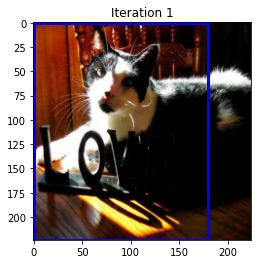

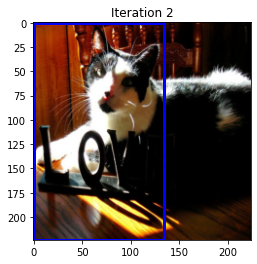

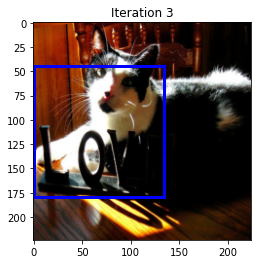

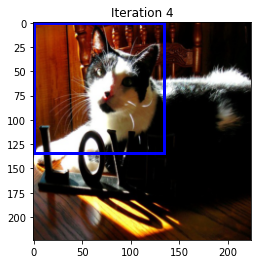

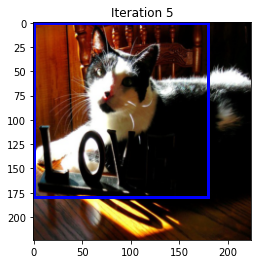

...

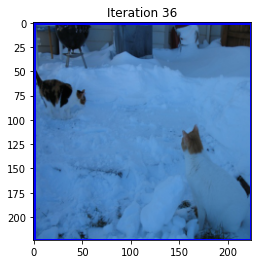

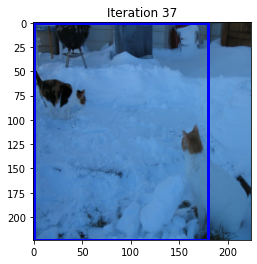

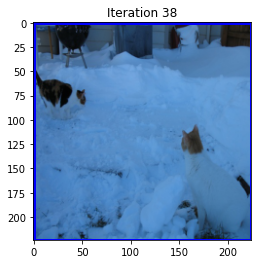

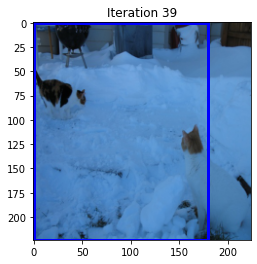

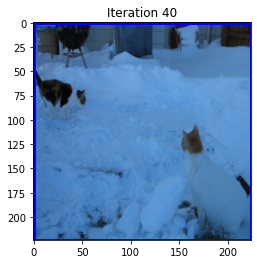

In [5]:
from utils.tools import classes
classe = random.choice(classes)
indices = np.random.choice(list(datasets_per_class[classe].keys()), size=5, replace=False)
agent = Agent(classe, load=True, model_name=model_name)

print("Class: " + classe)
for index in indices:
    image, gt_boxes = extract(index, datasets_per_class[classe])
    agent.predict_image(image, plot=True)